In [1]:
#ignore warning
import warnings
warnings.filterwarnings('ignore')

In [2]:
# import dependencies
import pandas as pd
import numpy as np
import seaborn as sns
import plotly.express as px
import matplotlib.pyplot as plt
from scipy import stats
import datetime
import os

In [3]:
# set seaborn theme
sns.set_style(style="whitegrid")

In [4]:
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)

In [5]:
%run Connect_Database.ipynb

Enter database password········
('INTC', 17.0, 4.0, 6.0, 7.0, datetime.datetime(2022, 2, 1, 0, 0), 'LAG_PERF', 'Semiconductors', 3.0, 31, 14.57, 'Customer Incidents,Business Ethics Incidents', 11.6, 21.21967741935484, 32.93, 2.53, 8.044999999999998, 16.08, 2.62, 6.166333333333333, 9.51, 4.79, 6.668666666666666, 9.67, 0.0, 1.1290322580645162, 4.0, 'None')


In [6]:
# Checking the company stocks
stocks_df

,Ticker,Date,Open,High,Low,Close,Adj Close,Volume
0,INTC,2018-03-16,51.169998,51.700001,50.990002,51.169998,47.260136,42559800.0
1,INTC,2018-03-19,50.740002,51.230000,49.930000,50.830002,46.946121,31115200.0
2,INTC,2018-03-20,50.880001,51.810001,50.849998,51.549999,47.611103,22215000.0
3,INTC,2018-03-21,51.549999,52.169998,51.169998,51.560001,47.620346,23239500.0
4,INTC,2018-03-22,50.740002,51.959999,50.599998,50.830002,46.946121,30916000.0
5,INTC,2018-03-23,50.590000,50.990002,49.360001,49.360001,45.588444,37683900.0
6,INTC,2018-03-26,50.740002,52.490002,50.320000,52.480000,48.470051,39306200.0
7,INTC,2018-03-27,53.009998,53.250000,50.779999,51.189999,47.278614,38777000.0
8,INTC,2018-03-28,50.500000,50.700001,49.009998,49.599998,45.810101,37970900.0
9,INTC,2018-03-29,49.980000,52.080002,49.869999,52.080002,48.100620,45265800.0


In [7]:
# Got the closing price for all stocks
def create_df(df, index, column, value):
    stocks_df = df.copy()
    stocks_df = stocks_df.pivot(index=index, columns=column, values=value)
    stocks_df = stocks_df.reset_index()
    stocks_df['Date'] = pd.to_datetime(stocks_df['Date'])
    stocks_df = stocks_df.sort_values(by = ['Date'])
    return stocks_df

In [8]:
# Get price of stocks, sorted by date
stock_price_df = create_df(stocks_df, 'Date', 'Ticker', 'Close')
stock_price_df

Ticker,Date,AAPL,ABT,ACN,ADM,AEP,AES,AMAT,AMGN,ANTM,AXP,BBY,BDX,BLK,C,CI,CL,CLX,COF,CSCO,DE,DLR,EBAY,ECL,EIX,EMN,EQIX,ES,ETR,EXC,F,FDX,GIS,GS,HIG,HPE,HSY,IBM,INTC,INTU,JNJ,JPM,KMB,LMT,LOW,MA,MRK,MSFT,NDAQ,NEM,NLSN,NOC,NVDA,OC,PEP,PG,QCOM,RF,SPGI,SYF,T,UNH,UPS,VZ,WFC
0,2018-03-16,44.505001,63.180000,160.889999,43.500000,67.809998,10.840000,59.439999,188.240005,228.110001,95.610001,69.730003,223.270004,563.659973,73.470001,168.669998,69.620003,128.490005,99.360001,45.009998,163.880005,106.370003,42.459999,138.080002,65.150002,107.790001,419.890015,58.259998,78.879997,27.375177,11.150000,252.029999,50.490002,267.600006,53.930000,18.790001,101.019997,153.212234,51.169998,178.589996,133.679993,115.440002,112.019997,331.399994,87.000000,182.550003,53.120228,94.599998,83.970001,37.389999,33.500000,338.630005,62.619999,81.010002,111.639999,78.970001,60.619999,19.629999,192.509995,35.200001,37.000000,227.860001,110.910004,48.560001,55.900002
1,2018-03-19,43.825001,62.259998,160.619995,43.060001,67.449997,10.770000,58.500000,182.550003,227.990005,94.839996,68.529999,219.529999,553.830017,72.699997,166.440002,70.059998,128.520004,98.650002,44.270000,159.529999,104.750000,42.090000,136.479996,64.029999,106.529999,411.709991,58.040001,78.540001,27.261057,11.010000,249.610001,50.209999,262.529999,53.450001,18.700001,100.070000,150.430206,50.830002,175.740005,130.240005,114.529999,111.089996,335.250000,85.790001,180.580002,52.127865,92.889999,83.620003,37.470001,32.680000,344.929993,60.250000,79.629997,110.360001,78.660004,58.369999,19.549999,190.449997,35.259998,36.580002,225.050003,108.459999,48.310001,55.480000
2,2018-03-20,43.810001,62.650002,162.880005,42.970001,67.449997,10.710000,59.230000,182.029999,229.979996,94.949997,70.040001,219.899994,557.520020,72.919998,165.000000,69.690002,128.119995,98.669998,44.369999,159.990005,104.970001,41.959999,136.630005,62.740002,106.080002,415.260010,57.669998,78.760002,27.325251,10.990000,251.990005,49.930000,263.190002,53.669998,18.780001,100.330002,149.330780,51.549999,178.149994,131.210007,114.639999,110.120003,335.600006,85.730003,182.509995,52.137405,93.129997,84.150002,37.299999,32.410000,347.579987,62.395000,79.790001,109.900002,78.309998,58.259998,19.459999,195.649994,35.400002,36.340000,226.779999,108.029999,47.689999,54.900002
3,2018-03-21,42.817501,62.419998,162.029999,42.619999,66.910004,10.800000,60.779999,181.589996,225.990005,94.739998,68.440002,218.500000,564.159973,73.320000,167.050003,68.690002,124.809998,98.180000,44.310001,158.050003,103.370003,41.669998,136.419998,61.930000,107.470001,411.839996,57.459999,78.250000,27.154066,11.100000,249.020004,45.509998,261.850006,53.400002,18.709999,98.470001,149.799240,51.560001,176.660004,131.190002,114.739998,108.400002,335.470001,87.250000,180.750000,52.185116,92.480003,84.209999,38.220001,32.439999,347.220001,62.139999,80.699997,108.739998,77.040001,56.810001,19.530001,193.809998,35.299999,36.000000,222.820007,107.650002,47.279999,54.790001
4,2018-03-22,42.212502,60.930000,150.229996,41.939999,67.360001,10.820000,58.959999,176.080002,218.850006,91.410004,67.250000,213.250000,539.419983,70.309998,165.339996,68.820000,125.510002,94.650002,43.070000,151.580002,102.910004,40.580002,134.119995,62.919998,103.970001,417.579987,57.509998,78.349998,27.368046,10.750000,236.270004,44.450001,252.600006,51.880001,18.320000,97.050003,145.401535,50.830002,174.830002,127.379997,109.949997,107.480003,327.149994,85.699997,175.520004,51.641220,89.790001,82.019997,37.610001,31.820000,338.829987,60.462502,79.080002,107.940002,76.410004,55.580002,18.620001,189.080002,33.730000,35.369999,215.210007,104.449997,46.880001,52.529999
5,2018-03-23,41.235001,59.500000,147.350006,42.049999,66.389999,10.720000,55.380001,169.429993,215.630005,90.449997,66.680000,210.600006,521.130005,67.900002,164.000000,68.379997,124.400002,92.389999,42.419998,148.000000,102.300003,39.709999,132.250000,62.160000,102.800003,401.679993,56.790001,77.349998,26.897289,10.560000,229.479996

In [9]:
stock_price_df.dtypes

Ticker
Date    datetime64[ns]
AAPL           float64
ABT            float64
ACN            float64
ADM            float64
AEP            float64
AES            float64
AMAT           float64
AMGN           float64
ANTM           float64
AXP            float64
BBY            float64
BDX            float64
BLK            float64
C              float64
CI             float64
CL             float64
CLX            float64
COF            float64
CSCO           float64
DE             float64
DLR            float64
EBAY           float64
ECL            float64
EIX            float64
EMN            float64
EQIX           float64
ES             float64
ETR            float64
EXC            float64
F              float64
FDX            float64
GIS            float64
GS             float64
HIG            float64
HPE            float64
HSY            float64
IBM            float64
INTC           float64
INTU           float64
JNJ            float64
JPM            float64
KMB            float64
LMT 

In [10]:
stock_price_df.describe()

Ticker,AAPL,ABT,ACN,ADM,AEP,AES,AMAT,AMGN,ANTM,AXP,BBY,BDX,BLK,C,CI,CL,CLX,COF,CSCO,DE,DLR,EBAY,ECL,EIX,EMN,EQIX,ES,ETR,EXC,F,FDX,GIS,GS,HIG,HPE,HSY,IBM,INTC,INTU,JNJ,JPM,KMB,LMT,LOW,MA,MRK,MSFT,NDAQ,NEM,NLSN,NOC,NVDA,OC,PEP,PG,QCOM,RF,SPGI,SYF,T,UNH,UPS,VZ,WFC
count,1007.000000,1007.000000,1007.000000,1007.000000,1007.000000,1007.000000,1007.000000,1007.000000,1007.000000,1007.000000,1007.000000,1007.000000,1007.000000,1007.000000,1007.000000,1007.000000,1007.000000,1007.000000,1007.000000,1007.000000,1007.000000,1007.000000,1007.000000,1007.000000,1007.000000,1007.000000,1007.000000,1007.000000,1007.000000,1007.000000,1007.000000,1007.000000,1007.000000,1007.000000,1007.000000,1007.000000,1007.000000,1007.000000,1007.000000,1007.000000,1007.000000,1007.000000,1007.000000,1007.000000,1007.000000,1007.000000,1007.000000,1007.000000,1007.000000,1007.000000,1007.000000,1007.000000,1007.000000,1007.000000,1007.000000,1007.000000,1007.000000,1007.000000,1007.000000,1007.000000,1007.000000,1007.000000,1007.000000,1007.000000
mean,90.187187,93.883148,224.918997,49.420983,83.281897,18.675213,75.646117,213.830646,306.662781,123.680626,88.374826,246.679960,598.458024,64.397100,195.617269,72.973436,168.654429,103.919156,48.520914,222.770824,132.454856,47.163327,189.532205,62.311658,90.610437,608.102196,78.544558,99.869791,32.109864,10.630497,213.507497,54.820596,256.849106,54.002284,14.200308,141.603823,127.989529,52.942443,330.260625,146.433982,123.443307,129.932642,354.990308,141.699196,288.485184,74.440972,185.628739,123.945700,49.097944,22.110209,330.491122,108.381254,68.510010,134.068640,118.755055,100.542205,17.005114,296.940358,34.542423,30.949176,313.055313,140.926971,55.938133,44.170050
std,43.161803,22.392827,67.350804,10.458563,8.160328,4.783247,39.463232,24.585995,63.387123,28.077615,20.753467,13.474329,173.963259,9.691300,27.542993,6.784438,26.687028,32.009669,5.897342,91.180365,18.244857,13.743157,27.541559,6.401935,19.788417,152.003505,10.638818,12.570118,3.957231,3.797549,53.490595,7.699948,74.937936,10.495105,2.483965,29.839684,10.541568,5.416357,127.894386,14.997355,23.411273,13.211931,36.493987,49.193509,63.795348,7.358401,73.211005,38.380986,13.152381,4.979164,38.174709,74.443680,17.964636,18.020235,23.732809,39.589642,3.892581,89.006094,8.597946,3.796162,76.991150,40.815800,3.368892,10.519539
min,35.547501,57.570000,133.669998,29.309999,62.930000,9.560000,28.990000,166.050003,174.679993,68.959999,48.240002,200.580002,327.420013,35.389999,130.059998,57.880001,114.800003,42.270000,33.200001,111.150002,100.989998,26.139999,125.220001,44.470001,38.389999,339.019989,52.869999,76.050003,21.383738,4.010000,90.489998,36.700001,134.970001,26.250000,7.830000,89.540001,90.602295,42.419998,167.679993,111.139999,79.029999,98.519997,245.220001,65.019997,169.699997,50.830154,87.180000,72.860001,29.600000,11.850000,226.229996,31.770000,31.110001,96.160004,70.940002,49.400002,7.360000,159.000000,12.800000,22.170000,194.860001,86.169998,46.290001,21.139999
25%,50.671249,75.789997,168.635002,42.240002,78.779999,14.765000,45.934999,193.009995,264.145004,101.615002,71.310001,238.385002,463.584991,60.410000,173.080002,67.325001,150.834999,84.305000,44.225000,151.544998,117.364998,36.209999,165.025002,57.570000,75.154999,447.595001,70.290001,90.785000,29.650499,8.605000,162.555000,48.000000,201.704994,46.514999,13.050000,111.590000,119.211281,48.665001,239.464996,133.909996,105.195000,119.110001,331.259995,100.180000,228.214996,72.095078,116.849998,92.120003,37.439999,19.464999,301.875000,51.427500,54.385000,117.945000,101.415001,66.695004,14.575000,211.405006,29.690001,28.735000,250.695000,108.520000,54.055000,38.125000
50%,74.702499,88.300003,201.589996,46.000000,84.139999,17.670000,57.860001,215.110001,286.500000,117.349998,81.660004,246.929993,533.010010,66.989998,193.559998,72.849998,163.259995,94.589996,47.320000,168.070007,131.500000,40.389999,194.860001,61.540001,84.449997,616.669983,82.379997,100.889999,31.997147,9.480000,226.509

In [11]:
new_stock_price = stock_price_df.describe()

In [12]:
new_price_data = new_stock_price.T

In [13]:
new_price_data

,count,mean,std,min,25%,50%,75%,max
Ticker,,,,,,,,
AAPL,1007.0,90.187187,43.161803,35.547501,50.671249,74.702499,128.464996,182.009995
ABT,1007.0,93.883148,22.392827,57.570000,75.789997,88.300003,116.570000,141.460007
ACN,1007.0,224.918997,67.350804,133.669998,168.635002,201.589996,265.615005,415.420013
ADM,1007.0,49.420983,10.458563,29.309999,42.240002,46.000000,57.485001,84.309998
AEP,1007.0,83.281897,8.160328,62.930000,78.779999,84.139999,89.334999,104.330002
AES,1007.0,18.675213,4.783247,9.560000,14.765000,17.670000,23.320000,28.910000
AMAT,1007.0,75.646117,39.463232,28.990000,45.934999,57.860001,118.424999,167.000000
AMGN,1007.0,213.830646,24.585995,166.050003,193.009995,215.110001,234.985001,260.950012
ANTM,1007.0,306.662781,63.387123,174.679993,264.145004,286.500000,343.190002,476.839996


In [14]:
print(stats.skew(new_price_data["std"]))

2.028850427656925


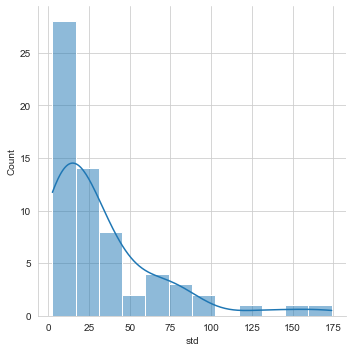

In [15]:
sns.displot(new_price_data, x="std", kind="hist", kde=True)


In [16]:
preferred_cols = ['min', 'mean', 'max']

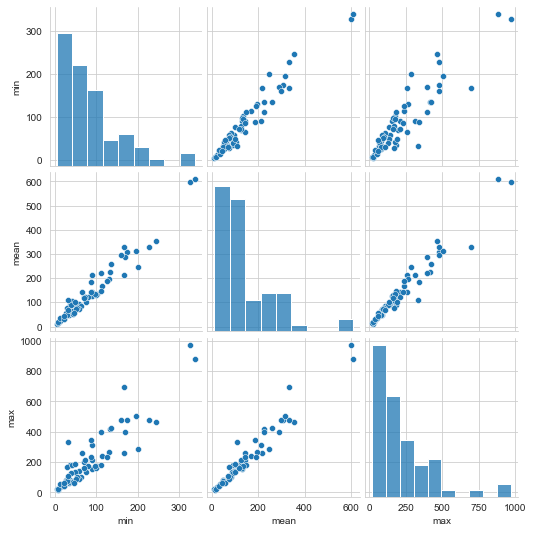

In [17]:
sns.pairplot(data=new_price_data, vars=preferred_cols)

In [18]:
corr_value = new_price_data["std"].corr(new_price_data["max"])

fig = px.scatter(
    data_frame=new_price_data,
    x="std",
    y="max",
#     marginal_x="histogram",
#     marginal_y="histogram",
    trendline="ols",
    trendline_color_override="red",
    title=f"Correlation between std and max is: {corr_value:.2f}",
)

fig.show()

In [19]:
corr_value = new_price_data["std"].corr(new_price_data["min"])

fig = px.scatter(
    data_frame=new_price_data,
    x="std",
    y="min",
#     marginal_x="histogram",
#     marginal_y="histogram",
    trendline="ols",
    trendline_color_override="red",
    title=f"Correlation between std and min is: {corr_value:.2f}",
)

fig.show()

In [20]:
corr_value = new_price_data["std"].corr(new_price_data["mean"])

fig = px.scatter(
    data_frame=new_price_data,
    x="std",
    y="mean",
#     marginal_x="histogram",
#     marginal_y="histogram",
    trendline="ols",
    trendline_color_override="red",
    title=f"Correlation between std and mean is: {corr_value:.2f}",
)

fig.show()